<h1 style= 'text-align: center;'> Tarea 3: Función ventana</h1>

<p style="text-align:center">
<img src="logo_uach-614a369aa9528.png"
width="600" height="600" alt="Tiny">

<p style='text-align: center;'><em>Integrantes: Aldo Henríquez </em></p>
<p style='text-align: center;'><em>Profesor: Victor Poblete</em></p>
<p style='text-align: center;'><em>Ayudante: Esteban Vargas</em></p>

In [2]:
#Importamos todas las librerias que nos serán utiles para realizar el ventaneo de la señal, importar audios, etc
import numpy as np
import librosa as lib
from IPython.display import Audio
import matplotlib.pyplot as plt
from scipy import signal
from scipy.fft import fft,ifft,fftshift

In [3]:
#importamos un audio y especificamos el sample rate
sig,fs=lib.load("AudioAmbiente.wav",sr=44100)
#La siguiente linea de codigo es para reproducir el Audio
Audio(sig, rate=fs)

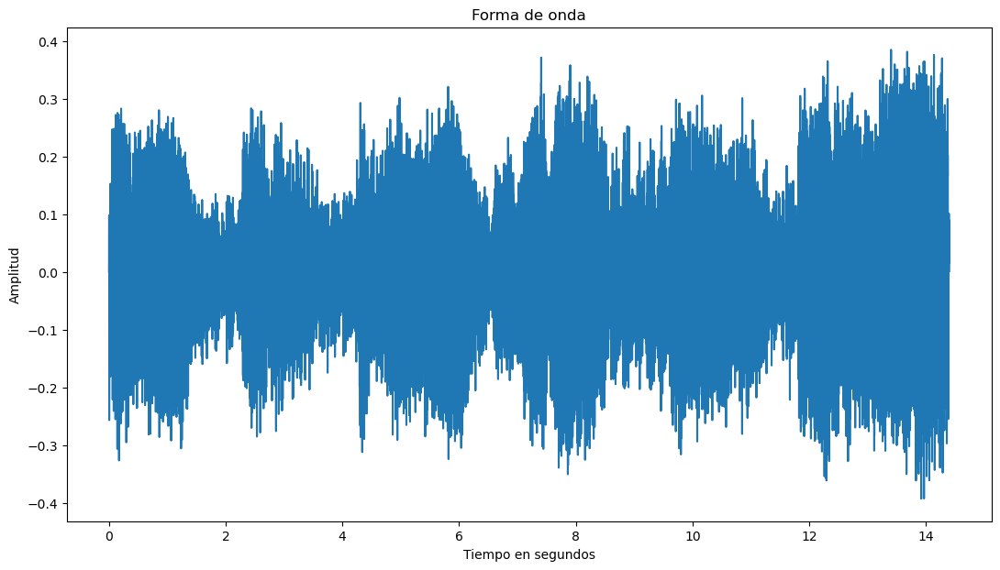

In [4]:
#Grafica de la señal sig
t=np.linspace(0, len(sig)/fs,len(sig))

plt.figure(figsize=(13,7));
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Forma de onda')
plt.plot(t,sig)


In [5]:
#Se especifica el overlap o el traslape de la señal y el largo de la ventana
len_f=1024
overlap=0.5

In [6]:
#Funcion que divide la señal en frames, dado un largo de ventana y su traslape
def ventanas(x,len_f,overlap):
    x=x.tolist()
    num_f=int(round(len(x)/(len_f-(len_f*overlap))))
    print(num_f)
    matriz_frames=[]
    for i in range(num_f):
        frame=x[i*round(len_f*overlap):i*round(len_f*overlap)+len_f]
        while len(frame)<len_f:
            frame.append(0)
        matriz_frames.append(frame)
    matf=np.array(matriz_frames)
    return matf

In [7]:
#En sig_frames tenemos la señal sig con la función ventanas aplicada para así dividir la señal en frames.
sig_frames=ventanas(sig,len_f,overlap)

1240


In [8]:
#(cantidad de ventanas,largo de la ventana)
sig_frames.shape

(1240, 1024)

In [9]:
#Largo de la ventana del frame 3
len(sig_frames[3])

1024

La linea de codigo anterior que nos da el largo del frame 3 nos sirve para corroborar que cada frame tiene el largo que se especifico en nuestra función ventanas.

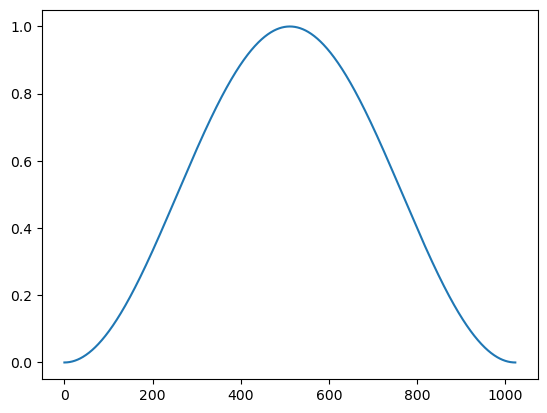

In [10]:
#Esta señal será la que nos dará el suavizado a cada uno de los frames
window = signal.windows.hann(1024)
plt.plot(window)

In [11]:
#Se le aplica el suavizado anterior a toda la matriz de frames
#Primero se crea una matriz vacia de la misma forma que sig_frames aqui iran los frames suavizados
smoothed_frames = np.empty_like(sig_frames)
#Luego se crea una iteracion para suavizar cada frame de sig_frames
for i in range(sig_frames.shape[0]):
    smoothed_frames[i] = sig_frames[i] * window

In [12]:
#se crea una matriz donde estan todos los frames suavizados con la transformada de fourier aplicada
fftframes = np.empty((smoothed_frames.shape[0], len_f), dtype=np.complex_)
for i in range(smoothed_frames.shape[0]):
    fftframes[i] = fft(smoothed_frames[i])

In [13]:
#Magnitud de la transformada para cada frames aplicada la transformada de fourier
magsig_fft = np.empty_like(fftframes, dtype=np.float_)
for i in range (fftframes.shape[0]):
    magsig_fft[i]=np.abs(fftframes[i])

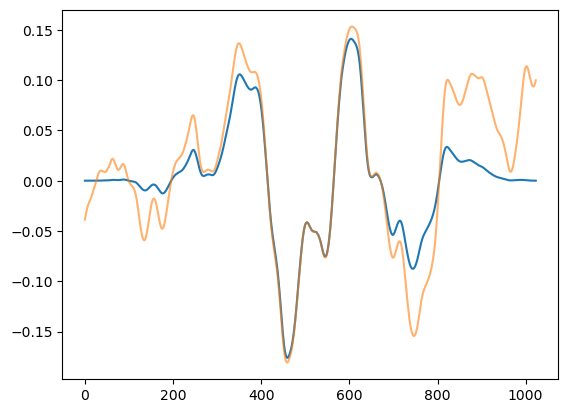

In [14]:
#Comparación del frame 1 con y sin suavizado
plt.plot(smoothed_frames[1],alpha=1); #frame 1 aplicando el suavizado.
plt.plot(sig_frames[1],alpha=0.6); #Es el frame 1 sin haber aplicado suavizado.

En la forma de onda de color azul se puede apreciar como se aplicó el suavizado dejando los laterales como si se hubiera aplicado una especie de fade in y fade out. Por otra parte en color naranjo se puede apreciar el frame 1 sin suavizado.

[-4.13266657e-03 -0.j          2.79437856e+00 -4.91750621j
 -5.57942274e+00 +0.54298809j ...  1.13657643e+01-16.54779894j
 -5.57942274e+00 -0.54298809j  2.79437856e+00 +4.91750621j]


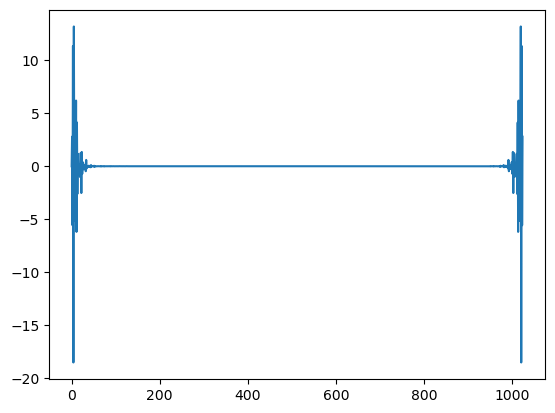

In [32]:
#En la siguiente linea se aplica la transformada de fourier solamente al frame 1 de la señal suavizada.
sigfft=fft(smoothed_frames[1])
print(sigfft)
#Grafica de la transformada de fourier aplicada al frame 1 suavizado.
plt.plot(sigfft)

[4.13266657e-03 5.65600733e+00 5.60578221e+00 ... 2.00751151e+01
 5.60578221e+00 5.65600733e+00]


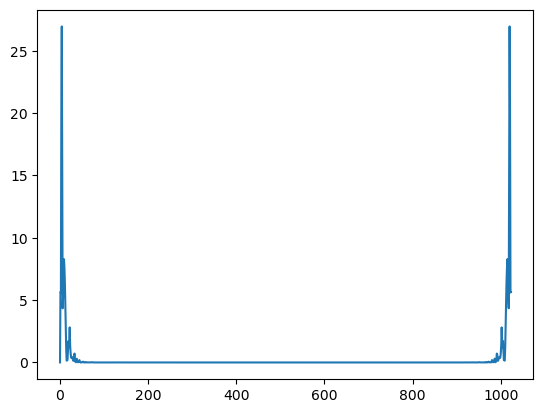

In [33]:
#Magnitud de la transformada
magsig_fft=np.abs(sigfft)
print(magsig_fft)
#grafica de la magnitud de la transformada del frame 1000
plt.plot(magsig_fft)


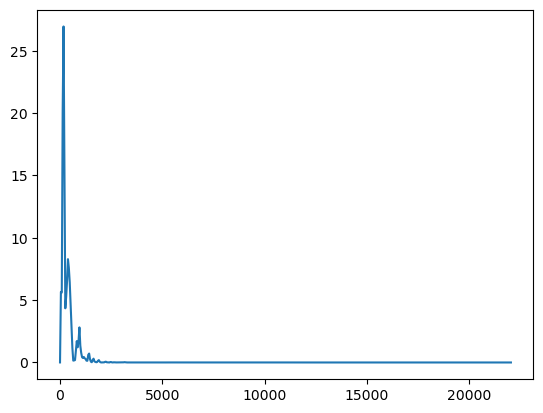

In [34]:
#Grafica de amplitud vs frecuencia del frame
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
plt.plot(b, magsig_fft[0:nfft//2]);

# Audio biofono

In [35]:
#importamos un audio que contiene sonido de diversas aves
sig1,fs=lib.load("Aves.wav",sr=44100)
#La siguiente linea de codigo es para reproducir el Audio
Audio(sig1, rate=fs)

Text(0.5, 1.0, 'Audio de Aves')

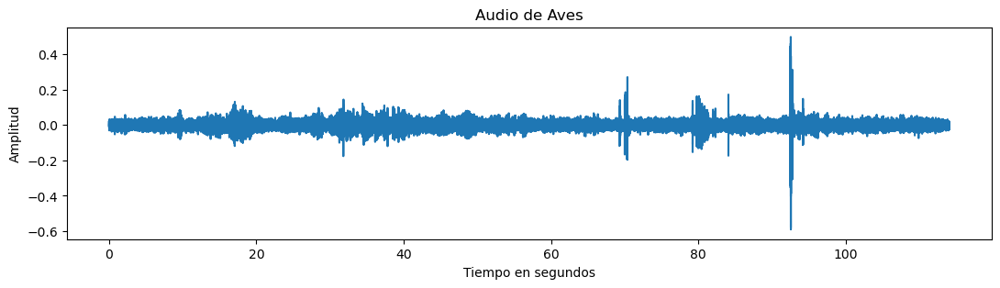

In [36]:
#Forma de onda temporal del audio biofono
t=np.linspace(0, len(sig1)/fs,len(sig1)) #tiempo en segundos

plt.figure(figsize=(13, 3))
plt.plot(t,sig1)
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Audio de Aves')

In [37]:
#Aplicamos la funcion de ventaneo para separar nuestra señal en diversos frames
sig1_frames=ventanas(sig1,len_f,overlap)

9823


In [38]:
#creamos la matriz con los frames suavizados
smoothed_frames1 = np.empty_like(sig1_frames)

for i in range(sig1_frames.shape[0]):
    smoothed_frames1[i] = sig1_frames[i] * window

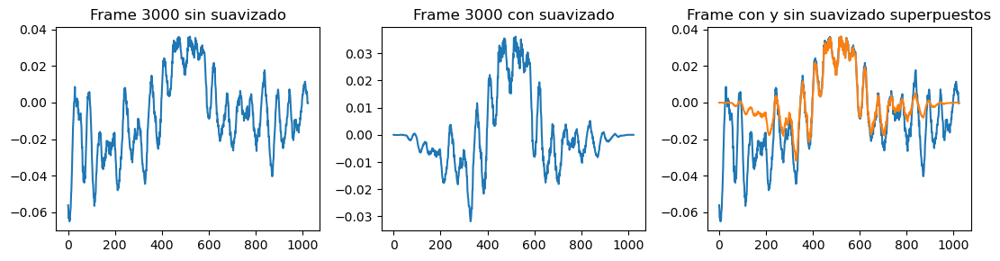

In [22]:
plt.figure(figsize=(11, 3))
a=3000 #frame
plt.subplot(1, 3, 1)
plt.plot(sig1_frames[a])
plt.title(f'Frame {a} sin suavizado')

plt.subplot(1, 3, 2)
plt.plot(smoothed_frames1[a])
plt.title(f'Frame {a} con suavizado')

plt.subplot(1, 3, 3)
plt.plot(sig1_frames[a])
plt.plot(smoothed_frames1[a])
plt.title(f'Frame con y sin suavizado superpuestos')

plt.tight_layout()
plt.show()


[0.7147953  4.18444929 5.89398207 ... 3.69263922 5.89398207 4.18444929]


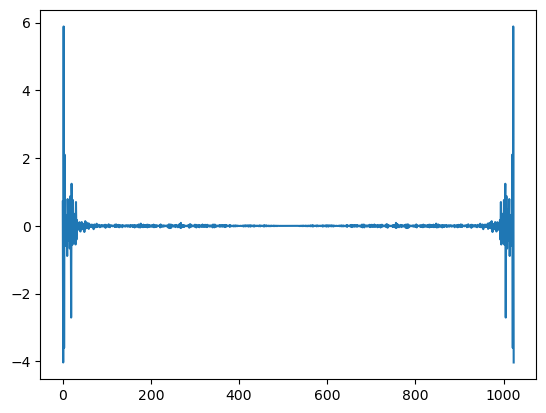

In [23]:
#se aplica transformada de fourier al frame 3000 suavizado
sigfft1=fft(smoothed_frames1[3000])
#Magnitud de la transformada
magsig_fft1=np.abs(sigfft1)
print(magsig_fft1)
plt.plot(sigfft1)

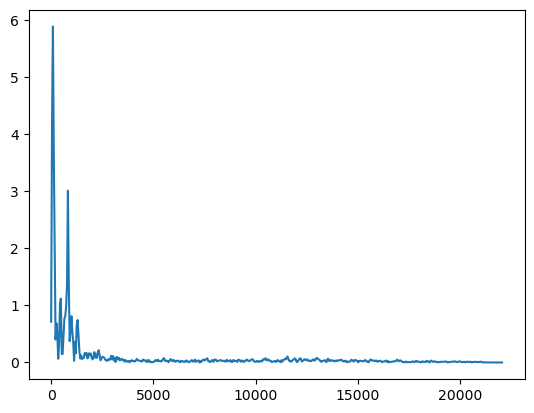

In [24]:
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
plt.plot(b, magsig_fft1[0:nfft//2]);

# Audio Antropofono

In [25]:
#importamos un audio que contiene sonido de una protesta
sig2,fs=lib.load("Autos.wav",sr=44100)
#La siguiente linea de codigo es para reproducir el Audio
Audio(sig2, rate=fs)

Text(0.5, 1.0, 'Audio de Bocinas')

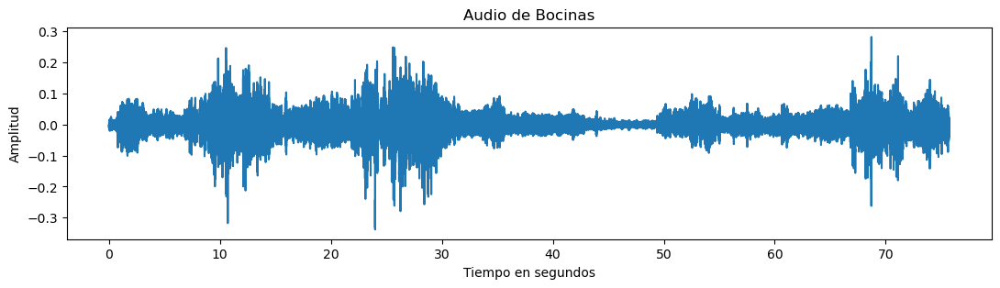

In [26]:
t = np.arange(len(sig2)) / fs 

plt.figure(figsize=(13, 3))
plt.plot(t,sig2)
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Audio de Bocinas')

In [27]:
#Aplicamos la funcion de ventaneo para separar nuestra señal en diversos frames.
sig2_frames=ventanas(sig2,len_f,overlap)

6523


In [28]:
#Creamos la matriz con los frames suavizados.
smoothed_frames2 = np.empty_like(sig2_frames)

for i in range(sig2_frames.shape[0]):
    smoothed_frames2[i] = sig2_frames[i] * window

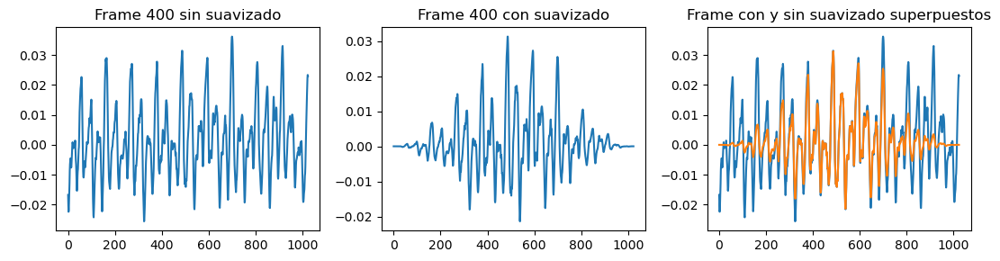

In [29]:
plt.figure(figsize=(11, 3))
b=400 #frame
plt.subplot(1, 3, 1)
plt.plot(sig2_frames[b])
plt.title(f'Frame {b} sin suavizado')

plt.subplot(1, 3, 2)
plt.plot(smoothed_frames2[b])
plt.title(f'Frame {b} con suavizado')

plt.subplot(1, 3, 3)
plt.plot(sig2_frames[b])
plt.plot(smoothed_frames2[b])
plt.title(f'Frame con y sin suavizado superpuestos')

plt.tight_layout()
plt.show()

[1.02075961 0.6965827  0.35914755 ... 0.35602771 0.35914755 0.6965827 ]


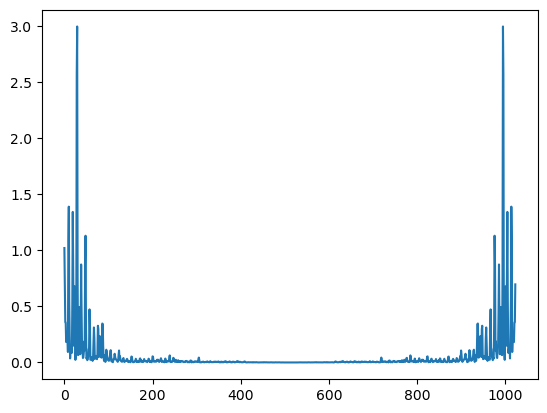

In [39]:
#se aplica transformada de fourier al frame 400 suavizado
sigfft2=fft(smoothed_frames2[400])
#Magnitud de la transformada
magsig_fft2=np.abs(sigfft2)
print(magsig_fft2)
plt.plot(magsig_fft2)

In [ ]:
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
plt.plot(b, magsig_fft2[0:nfft//2]);

# Audio Geofono

In [ ]:
#importamos un audio que contiene sonidos de lluvia
sig3,fs=lib.load("Rain.wav",sr=44100)
#La siguiente linea de codigo es para reproducir el Audio
Audio(sig3, rate=fs)

In [ ]:
t = np.arange(len(sig3)) / fs 

plt.figure(figsize=(13, 3))
plt.plot(t,sig3)
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Audio de lluvia ')

In [ ]:
#Separamos la señal en frames
sig3_frames=ventanas(sig3,len_f,overlap)

In [ ]:
#Creamos la matriz con los frames suavizados.
smoothed_frames3 = np.empty_like(sig3_frames)

for i in range(sig3_frames.shape[0]):
    smoothed_frames3[i] = sig3_frames[i] * window

In [ ]:
plt.figure(figsize=(11, 3))
c=12999 #frame
plt.subplot(1, 3, 1)
plt.plot(sig3_frames[c])
plt.title(f'Frame {c} sin suavizado')

plt.subplot(1, 3, 2)
plt.plot(smoothed_frames3[c])
plt.title(f'Frame {c} con suavizado')

plt.subplot(1, 3, 3)
plt.plot(sig3_frames[c])
plt.plot(smoothed_frames3[c])
plt.title(f'Frame con y sin suavizado superpuestos')

plt.tight_layout()
plt.show()

In [ ]:
#se aplica transformada de fourier al frame 12999 suavizado
sigfft3=fft(smoothed_frames3[12999])
#Magnitud de la transformada
magsig_fft3=np.abs(sigfft3)
print(magsig_fft3)
plt.plot(sigfft3)

In [ ]:
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
graf3 = plt.plot(b, magsig_fft3[0:nfft//2]);

# comparación de graficos

NameError: name 'magsig_fft3' is not defined

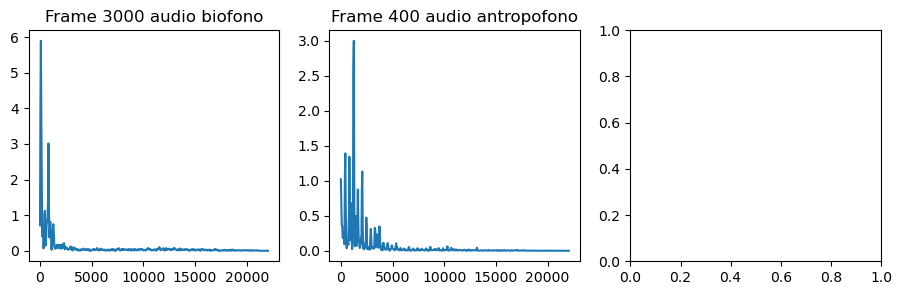

In [40]:
plt.figure(figsize=(11, 3))
c=12999 #frame
plt.subplot(1, 3, 1)
plt.plot(b, magsig_fft1[0:nfft//2])
plt.title('Frame 3000 audio biofono')

plt.subplot(1, 3, 2)
plt.plot(b, magsig_fft2[0:nfft//2])
plt.title('Frame 400 audio antropofono')

plt.subplot(1, 3, 3)
plt.plot(b, magsig_fft3[0:nfft//2])
plt.title('Frame 12999 audio geofono')

plt.tight_layout()
plt.show()

# Conclusión
Como se puede apreciar en los diversos frames de los distintos audios, biofono geofono y antropogono, tenemos que cada uno tiene comportamientos diferentes respecto a su contenido espectral, en el frame 400 del audio antropofono se puede ver cada frecuencia muy marcada, pudiendo distinguirse con claridad cada una, en el frame 12999 del audio geofono se puede apreciar como las frecuencias graves son las que mas resaltan y al aumentar la frecuencia la señal se vuelve ligeramente plana esto debido a que la señal analizada es de lluvia. Por otra parte tenemos el frame 3000 del audio biofonos que contiene variedad de tipo de aves, donde tambien se pueden apreciar ciertos picos de magnitud en ciertas frecuencias especificas.

In [ ]:
pwd